# Machine Learning for Cities - Homework assignment 2
DUE on 5/3/2016 by 11:59pm EST

This homework assignment will involve analyzing a dataset of all recorded NYPD “Terry” police
stops in New York City in the years 2011 - 2012, as the (compressed) file ‘hw_2_stops.csv.zip’.
Note that in contrast to the previous assignment and the in-class examples with this dataset, I have provided you with a few additional features and I have not removed missing data. Make
sure you only fit models that make sense (e.g. if you are trying to predict arrest, don’t use
found.weapon as a feature). Also, make sure all plots have titles and axis labels. 

In [58]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score
plt.style.use('seaborn-darkgrid')
%matplotlib inline

In [2]:
data = pd.read_csv('hw_2_stops.csv').dropna()
data.head()

,suspected.crime,found.weapon,found.gun,arrested,frisked,searched,summons.issued,found.contraband,force.hands,force.wall,...,additional.time,additional.sights,additional.other,radio.run,day,month,time.period,date,lat,lon
0,burglary,False,False,False,True,False,False,False,True,False,...,True,False,False,False,Saturday,January,1,2011-01-01,40.699548,-73.832452
1,robbery,False,False,False,True,False,False,False,False,False,...,False,False,False,False,Saturday,January,1,2011-01-01,40.752780,-73.866268
2,cpw,False,False,False,True,False,False,False,True,True,...,True,False,False,False,Saturday,January,1,2011-01-01,40.587972,-73.807674
3,cpw,False,False,False,True,False,False,False,True,False,...,True,False,False,False,Saturday,January,1,2011-01-01,40.587972,-73.807674
4,cpw,False,False,False,True,False,False,False,True,False,...,True,False,False,False,Saturday,January,1,2011-01-01,40.587972,-73.807674


In [18]:
data.dtypes

suspected.crime              object
found.weapon                   bool
found.gun                      bool
arrested                       bool
frisked                        bool
searched                       bool
summons.issued                 bool
found.contraband               bool
force.hands                    bool
force.wall                     bool
force.ground                   bool
force.drawn                    bool
force.pointed                  bool
force.baton                    bool
force.handcuffs                bool
force.pepper                   bool
force.other                    bool
suspect.race                 object
suspect.age                   int64
suspect.build                object
suspect.sex                  object
suspect.height              float64
suspect.weight              float64
stopped.bc.desc                bool
stopped.bc.violent             bool
stopped.bc.other               bool
stopped.bc.object              bool
stopped.bc.casing           

In [7]:
data[u'suspected.crime'].value_counts()[:10]

cpw                                           288157
robbery                                       247726
burglary                                      120167
grand larceny auto                            107607
criminal trespass                              81801
grand larceny                                  55068
criminal possession of marihuana               52946
assault                                        44802
petit larceny                                  28284
criminal possesion of controlled substance     25734
Name: suspected.crime, dtype: int64

In [61]:
data['suspect.build'].value_counts()

medium      669320
thin        367992
heavy        92448
unknown      10348
muscular      4357
Name: suspect.build, dtype: int64

### Problem 1

In [21]:
print data.size
df = data[(data[u'suspected.crime'] == 'criminal possession of marihuana') | (data[u'suspected.crime'] == 'criminal possesion of controlled substance')]
print df.size

62945575
4327400


In [35]:
Y = df[u'found.contraband']
X = df.drop([u'found.contraband'], axis=1)

In [37]:
X = pd.get_dummies(X)

In [38]:
from sklearn.cross_validation import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=666)

In [72]:
clf = RandomForestClassifier(n_jobs=-1, n_estimators=1000)
clf = clf.fit(X_train, Y_train)
Y_pred = clf.predict(X_test)
print "OS Accuracy = {}".format(accuracy_score(Y_test, Y_pred))

OS Accuracy = 0.945653279105


In [73]:
prob = clf.predict_proba(X_test)

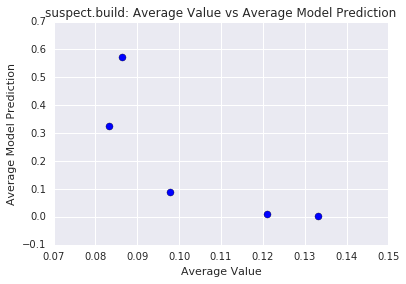

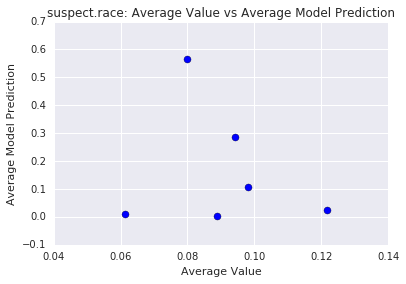

In [93]:
for col_name in ['suspect.build', 'suspect.race']:    
    col = [x for x in X.columns if col_name in x]
    plot_x = []
    plot_y = []
    for name in col:
        plot_x.append(prob[np.where(X_test[name] == 1)].mean(axis=0)[1])
        plot_y.append(X[name].mean())
    figure, ax = plt.subplots()
    plt.scatter(plot_x, plot_y, s=50)
    plt.xlabel('Average Value')
    plt.ylabel('Average Model Prediction')
    plt.title('{}: Average Value vs Average Model Prediction'.format(col_name))

In problem 1, I selected __found.contraband__ as my target variable while the other columns as my predictors. To split the data, I use __train_test_split__ function in sklearn to __randomly__ select 75% of data as my train set and the rest as my test set since I believed time might also affect my target variable. I then applied Random Forest Classifier with __1000__ trees (I also set n_jobs=-1 since If -1 since I wanted the number of jobs set to the number of cores) to build the model and the accuracy on my test set was approximately __94.6%__. Finally, I chose __suspect.build__ and __suspect.race__ for the categorical features to show my result. The plots have a point for each category in __suspect.build/suspect.race__, where the x value is the average model prediction, and the y value is the real average value of __found.contraband__. Judging from both graphs, it is observed that for a particular group of people (either one of nodes or races), the model is pretty accurate.

* * *

### Problem 2

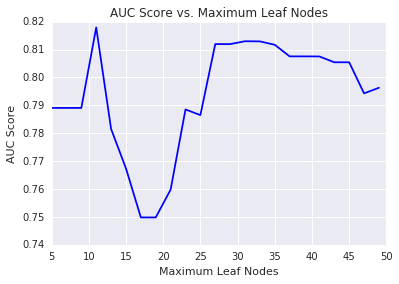

In [128]:
plotdata = [] 
for i in range(5,50,2):
    clf = DecisionTreeClassifier(max_leaf_nodes=i)
    clf = clf.fit(X_train, Y_train)
    plotdata.append(roc_auc_score(Y_test, clf.predict(X_test)))
plt.plot(range(5,50,2), plotdata)
plt.xlabel('Maximum Leaf Nodes')
plt.ylabel('AUC Score')
plt.title('AUC Score vs. Maximum Leaf Nodes')

In [131]:
clf = DecisionTreeClassifier(min_samples_leaf=11)
clf = clf.fit(X_train, Y_train)

In [132]:
export_graphviz(clf, feature_names=X.columns)

In [133]:
import pydot
from IPython.display import Image
graph = pydot.graph_from_dot_file('tree.dot')
graph.write_png('tree.png')
Image(filename='tree.png') 

For splitting, target variables and predictors, I used the same set up as problem 1 in problem 2. I then applied the data to a decision tree model by trying the __max_leaf_nodes__ from 5 to 50 with an interval of 2. According to the graph, __max_leaf_nodes = 11__  gave the best AUC score. After that, I used __export_graphviz__ to visualize my decision tree. Finally, the __pydot__ library helped me to convert it to a png file and it was shown as the graph above.

### Notice: The tree graph is very big and detailed, be careful when zooming in.